# --------WALMART SALES FORECASTING USING MACHINE LEARNING--------

 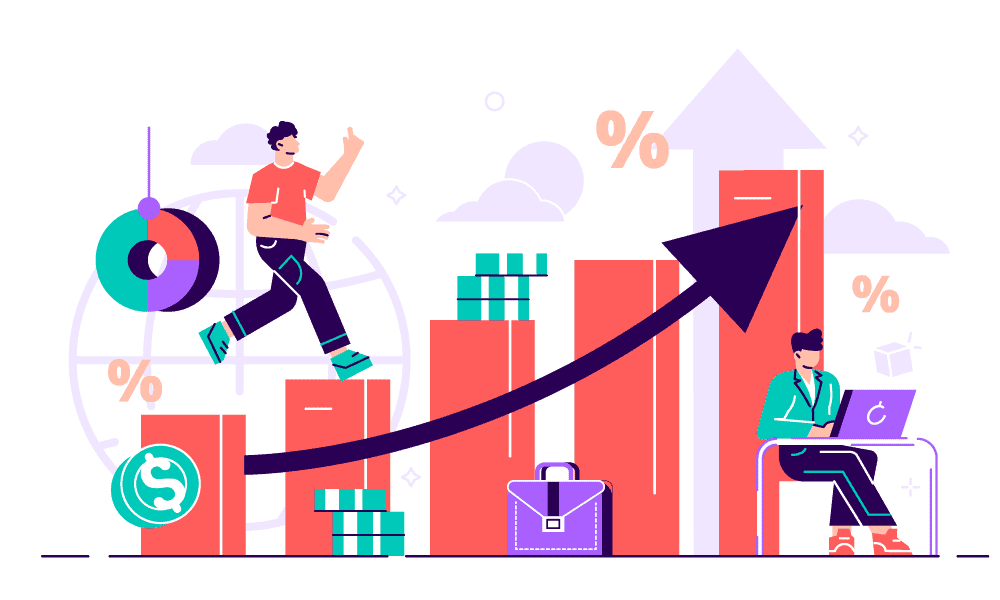

# Business Problem Statement

In this project, we have historical sales data for 45 Walmart stores located in different regions. Each store contains many departments, and participants must project the sales for each department in each store. To add to the challenge, selected holiday markdown events are included in the dataset. These markdowns are known to affect sales, but it is challenging to predict which departments are affected and the extent of the impact.

You may only use the provided data to make your predictions.

# Data

There is the historical sales data for 45 Walmart stores located in different regions. Each store contains a number of departments, and you are tasked with predicting the department-wide sales for each store.

In addition, Walmart runs several promotional markdown events throughout the year. These markdowns precede prominent holidays, the four largest of which are the Super Bowl, Labor Day, Thanksgiving, and Christmas. The weeks including these holidays are weighted five times higher in the evaluation than non-holiday weeks. Part of the challenge presented by this competition is modeling the effects of markdowns on these holiday weeks in the absence of complete/ideal historical data.

The basic idea of analyzing the Walmart Forecasting dataset is to get a fair idea about the factors affecting the Sales of the Walmart Store.

# Problem Statement

<b> By using these data we have to Predict the walmart sales forecasting based on different parameters</b>

# Data Description

stores.csv

    This file contains anonymized information about the 45 stores, indicating the type and size of store.

train.csv

    This is the historical training data, which covers to 2010-02-05 to 2012-11-01. Within this file you will find the following fields:

    Store - the store number
    Dept - the department number
    Date - the week
    Weekly_Sales -  sales for the given department in the given store
    IsHoliday - whether the week is a special holiday week
    test.csv

This file is identical to train.csv, except we have withheld the weekly sales. You must predict the sales for each triplet of store, department, and date in this file.

features.csv

    This file contains additional data related to the store, department, and regional activity for the given dates. It contains the following fields:

    Store - the store number
    Date - the week
    Temperature - average temperature in the region
    Fuel_Price - cost of fuel in the region
    MarkDown1-5 - anonymized data related to promotional markdowns that Walmart is running. MarkDown data is only available after Nov 2011, and is not available for all stores all the time. Any missing value is marked with an NA.
    CPI - the consumer price index
    Unemployment - the unemployment rate
    IsHoliday - whether the week is a special holiday week

For convenience, the four holidays fall within the following weeks in the dataset (not all holidays are in the data):

Super Bowl: 12-Feb-10, 11-Feb-11, 10-Feb-12, 8-Feb-13
Labor Day: 10-Sep-10, 9-Sep-11, 7-Sep-12, 6-Sep-13
Thanksgiving: 26-Nov-10, 25-Nov-11, 23-Nov-12, 29-Nov-13
Christmas: 31-Dec-10, 30-Dec-11, 28-Dec-12, 27-Dec-13

# Importing Essential Libraries

In [1]:
import numpy as np
import pandas as pd
from math import sqrt


import seaborn as sns 
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import iplot
from matplotlib import pyplot as plt


from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score


import warnings
from pandas.core.common import SettingWithCopyWarning
warnings.simplefilter(action="ignore", category=Warning)

# Reading the Data from CSV Files 

In [2]:
train_df = pd.read_csv('train.csv')
features_df = pd.read_csv('features.csv')
stores_df = pd.read_csv('stores.csv')
test_df = pd.read_csv('test.csv')

# Data Analysis

In [3]:
# checking first five rows of the train data

train_df.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday
0,1,1,2010-02-05,24924.50,False
1,1,1,2010-02-12,46039.49,True
2,1,1,2010-02-19,41595.55,False
3,1,1,2010-02-26,19403.54,False
4,1,1,2010-03-05,21827.90,False


In [4]:
# checking the size of the training data

train_df.size

2107850

In [5]:
# checking the shape of the training data

train_df.shape

(421570, 5)

In [6]:
# getting the information of the training Data

train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         421570 non-null  int64  
 1   Dept          421570 non-null  int64  
 2   Date          421570 non-null  object 
 3   Weekly_Sales  421570 non-null  float64
 4   IsHoliday     421570 non-null  bool   
dtypes: bool(1), float64(1), int64(2), object(1)
memory usage: 13.3+ MB


In [7]:
# peforming some mathematical operations

train_df.describe()

,Store,Dept,Weekly_Sales
count,421570.000000,421570.000000,421570.000000
mean,22.200546,44.260317,15981.258123
std,12.785297,30.492054,22711.183519
min,1.000000,1.000000,-4988.940000
25%,11.000000,18.000000,2079.650000
50%,22.000000,37.000000,7612.030000
75%,33.000000,74.000000,20205.852500
max,45.000000,99.000000,693099.360000


In [8]:
# getting columns of the training data

train_df.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday'], dtype='object')

In [9]:
# checking the null values in the training data

train_df.isnull().sum()

Store           0
Dept            0
Date            0
Weekly_Sales    0
IsHoliday       0
dtype: int64

In [10]:
# checking the data types

train_df.dtypes

Store             int64
Dept              int64
Date             object
Weekly_Sales    float64
IsHoliday          bool
dtype: object

In [11]:
# defining the functions for the value counts and data types of data

def Value_counts(df):
    for i in df[df.columns]:
        print("Data Type for the", i ,"column is: ",df[i].dtypes)
        print(df[i].value_counts())
        print(" ")
        print(" ")

In [12]:
# calling the function for the training data

Value_counts(train_df)

Data Type for the Store column is:  int64
13    10474
10    10315
4     10272
1     10244
2     10238
24    10228
27    10225
34    10224
20    10214
6     10211
32    10202
19    10148
31    10142
28    10113
41    10088
11    10062
23    10050
14    10040
40    10017
15     9901
8      9895
39     9878
17     9864
18     9859
26     9854
25     9804
7      9762
12     9705
22     9688
45     9637
21     9582
35     9528
29     9455
16     9443
3      9036
5      8999
9      8867
38     7362
37     7206
44     7169
30     7156
42     6953
43     6751
33     6487
36     6222
Name: Store, dtype: int64
 
 
Data Type for the Dept column is:  int64
1     6435
13    6435
2     6435
46    6435
67    6435
      ... 
78     235
77     150
65     143
39      16
43      12
Name: Dept, Length: 81, dtype: int64
 
 
Data Type for the Date column is:  object
2011-12-23    3027
2011-11-25    3021
2011-12-16    3013
2011-12-09    3010
2012-02-17    3007
              ... 
2010-07-09    2903
2010-07-16

Performing the similar operations on the Features Data

In [13]:
features_df.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False
3,1,2010-02-26,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False
4,1,2010-03-05,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False


In [14]:
features_df.size

98280

In [15]:
features_df.shape

(8190, 12)

In [16]:
features_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         8190 non-null   int64  
 1   Date          8190 non-null   object 
 2   Temperature   8190 non-null   float64
 3   Fuel_Price    8190 non-null   float64
 4   MarkDown1     4032 non-null   float64
 5   MarkDown2     2921 non-null   float64
 6   MarkDown3     3613 non-null   float64
 7   MarkDown4     3464 non-null   float64
 8   MarkDown5     4050 non-null   float64
 9   CPI           7605 non-null   float64
 10  Unemployment  7605 non-null   float64
 11  IsHoliday     8190 non-null   bool   
dtypes: bool(1), float64(9), int64(1), object(1)
memory usage: 712.0+ KB


In [17]:
features_df.describe()

,Store,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
count,8190.000000,8190.000000,8190.000000,4032.000000,2921.000000,3613.000000,3464.000000,4050.000000,7605.000000,7605.000000
mean,23.000000,59.356198,3.405992,7032.371786,3384.176594,1760.100180,3292.935886,4132.216422,172.460809,7.826821
std,12.987966,18.678607,0.431337,9262.747448,8793.583016,11276.462208,6792.329861,13086.690278,39.738346,1.877259
min,1.000000,-7.290000,2.472000,-2781.450000,-265.760000,-179.260000,0.220000,-185.170000,126.064000,3.684000
25%,12.000000,45.902500,3.041000,1577.532500,68.880000,6.600000,304.687500,1440.827500,132.364839,6.634000
50%,23.000000,60.710000,3.513000,4743.580000,364.570000,36.260000,1176.425000,2727.135000,182.764003,7.806000
75%,34.000000,73.880000,3.743000,8923.310000,2153.350000,163.150000,3310.007500,4832.555000,213.932412,8.567000
max,45.000000,101.950000,4.468000,103184.980000,104519.540000,149483.310000,67474.850000,771448.100000,228.976456,14.313000


In [18]:
features_df.columns

Index(['Store', 'Date', 'Temperature', 'Fuel_Price', 'MarkDown1', 'MarkDown2',
       'MarkDown3', 'MarkDown4', 'MarkDown5', 'CPI', 'Unemployment',
       'IsHoliday'],
      dtype='object')

In [19]:
features_df.isnull().sum().sum()

24040

In [20]:
features_df.isnull().sum().sort_values(ascending=False)

MarkDown2       5269
MarkDown4       4726
MarkDown3       4577
MarkDown1       4158
MarkDown5       4140
CPI              585
Unemployment     585
Store              0
Date               0
Temperature        0
Fuel_Price         0
IsHoliday          0
dtype: int64

In [21]:
features_df.dtypes

Store             int64
Date             object
Temperature     float64
Fuel_Price      float64
MarkDown1       float64
MarkDown2       float64
MarkDown3       float64
MarkDown4       float64
MarkDown5       float64
CPI             float64
Unemployment    float64
IsHoliday          bool
dtype: object

In [22]:
Value_counts(features_df)

Data Type for the Store column is:  int64
4     182
2     182
10    182
14    182
18    182
22    182
26    182
30    182
34    182
38    182
42    182
3     182
7     182
11    182
15    182
19    182
23    182
27    182
31    182
35    182
39    182
6     182
45    182
8     182
41    182
12    182
16    182
20    182
24    182
28    182
32    182
36    182
40    182
44    182
1     182
5     182
9     182
13    182
17    182
21    182
25    182
29    182
33    182
37    182
43    182
Name: Store, dtype: int64
 
 
Data Type for the Date column is:  object
2012-01-20    45
2012-01-27    45
2013-04-05    45
2011-02-18    45
2013-03-22    45
              ..
2011-12-30    45
2012-05-25    45
2012-12-14    45
2013-01-04    45
2011-09-09    45
Name: Date, Length: 182, dtype: int64
 
 
Data Type for the Temperature column is:  float64
70.28    11
50.43    11
67.87    10
76.03     9
70.87     9
         ..
68.50     1
79.03     1
13.29     1
34.45     1
57.82     1
Name: Temperature, Length

Performing same operations on the store data

In [23]:
stores_df.head()

,Store,Type,Size
0,1,A,151315
1,2,A,202307
2,3,B,37392
3,4,A,205863
4,5,B,34875


In [24]:
stores_df.shape

(45, 3)

In [25]:
stores_df.size

135

In [26]:
stores_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45 entries, 0 to 44
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Store   45 non-null     int64 
 1   Type    45 non-null     object
 2   Size    45 non-null     int64 
dtypes: int64(2), object(1)
memory usage: 1.2+ KB


In [27]:
stores_df.describe()

,Store,Size
count,45.000000,45.000000
mean,23.000000,130287.600000
std,13.133926,63825.271991
min,1.000000,34875.000000
25%,12.000000,70713.000000
50%,23.000000,126512.000000
75%,34.000000,202307.000000
max,45.000000,219622.000000


In [28]:
stores_df.columns

Index(['Store', 'Type', 'Size'], dtype='object')

In [29]:
stores_df.isnull().sum().sum()

0

In [30]:
stores_df.dtypes

Store     int64
Type     object
Size      int64
dtype: object

In [31]:
Value_counts(stores_df)

Data Type for the Store column is:  int64
1     1
24    1
26    1
27    1
28    1
29    1
30    1
31    1
32    1
33    1
34    1
35    1
36    1
37    1
38    1
39    1
40    1
41    1
42    1
43    1
44    1
25    1
23    1
2     1
22    1
3     1
4     1
5     1
6     1
7     1
8     1
9     1
10    1
11    1
12    1
13    1
14    1
15    1
16    1
17    1
18    1
19    1
20    1
21    1
45    1
Name: Store, dtype: int64
 
 
Data Type for the Type column is:  object
A    22
B    17
C     6
Name: Type, dtype: int64
 
 
Data Type for the Size column is:  int64
39910     3
39690     3
203819    2
112238    1
114533    1
219622    1
205863    1
41062     1
42988     1
57197     1
152513    1
196321    1
126512    1
125833    1
203750    1
70713     1
34875     1
128107    1
155083    1
118221    1
158114    1
200898    1
120653    1
202307    1
93188     1
119557    1
155078    1
140167    1
202505    1
207499    1
37392     1
184109    1
151315    1
204184    1
123737    1
103681    1


Performing the same operations on the test Data

In [32]:
test_df.head()

,Store,Dept,Date,IsHoliday
0,1,1,2012-11-02,False
1,1,1,2012-11-09,False
2,1,1,2012-11-16,False
3,1,1,2012-11-23,True
4,1,1,2012-11-30,False


In [33]:
test_df.columns

Index(['Store', 'Dept', 'Date', 'IsHoliday'], dtype='object')

In [34]:
test_df.shape

(115064, 4)

In [35]:
test_df.size

460256

In [36]:
test_df.isnull().sum().sum()

0

# Missing Value Treatment

In [37]:
features_df["Unemployment"] = features_df["Unemployment"].fillna(features_df["Unemployment"].mean())

features_df["CPI"] = features_df["CPI"].fillna(features_df["CPI"].mean())

features_df = features_df.drop(["MarkDown1","MarkDown2","MarkDown3","MarkDown4","MarkDown5"],axis=1)

In [38]:
features_df.isnull().sum().sum()

0

In [39]:
new_data = features_df.merge(stores_df, how='inner', on=['Store'])

# Feature Extraction 

In [40]:
from datetime import datetime
new_data['Date'] = pd.to_datetime(new_data['Date'])
train_df['Date'] = pd.to_datetime(train_df['Date'])
test_df['Date'] = pd.to_datetime(test_df['Date'])

In [41]:
new_data['Week'] = new_data.Date.dt.week # for the week data
new_data['Year'] = new_data.Date.dt.year # for the year data
new_data["Day"]  = new_data.Date.dt.day # for the Day data

In [42]:
new_data.head()

,Store,Date,Temperature,Fuel_Price,CPI,Unemployment,IsHoliday,Type,Size,Week,Year,Day
0,1,2010-02-05,42.31,2.572,211.096358,8.106,False,A,151315,5,2010,5
1,1,2010-02-12,38.51,2.548,211.242170,8.106,True,A,151315,6,2010,12
2,1,2010-02-19,39.93,2.514,211.289143,8.106,False,A,151315,7,2010,19
3,1,2010-02-26,46.63,2.561,211.319643,8.106,False,A,151315,8,2010,26
4,1,2010-03-05,46.50,2.625,211.350143,8.106,False,A,151315,9,2010,5


In [43]:
# Merging with train_df

train_merge = train_df.merge(new_data, how='inner', on=['Store', 'Date', 'IsHoliday']).sort_values(by=['Store','Dept','Date']).reset_index(drop=True)

In [44]:
# Merging with test_df

test_merge = test_df.merge(new_data, how='inner', on=['Store', 'Date', 'IsHoliday']).sort_values(by=['Store','Dept','Date']).reset_index(drop=True)

In [45]:
train_merge

,Store,Dept,Date,Weekly_Sales,IsHoliday,Temperature,Fuel_Price,CPI,Unemployment,Type,Size,Week,Year,Day
0,1,1,2010-02-05,24924.50,False,42.31,2.572,211.096358,8.106,A,151315,5,2010,5
1,1,1,2010-02-12,46039.49,True,38.51,2.548,211.242170,8.106,A,151315,6,2010,12
2,1,1,2010-02-19,41595.55,False,39.93,2.514,211.289143,8.106,A,151315,7,2010,19
3,1,1,2010-02-26,19403.54,False,46.63,2.561,211.319643,8.106,A,151315,8,2010,26
4,1,1,2010-03-05,21827.90,False,46.50,2.625,211.350143,8.106,A,151315,9,2010,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
421565,45,98,2012-09-28,508.37,False,64.88,3.997,192.013558,8.684,B,118221,39,2012,28
421566,45,98,2012-10-05,628.10,False,64.89,3.985,192.170412,8.667,B,118221,40,2012,5
421567,45,98,2012-10-12,1061.02,False,54.47,4.000,192.327265,8.667,B,118221,41,2012,12
421568,45,98,2012-10-19,760.01,False,56.47,3.969,192.330854,8.667,B,118221,42,2012,19


In [46]:
test_merge

,Store,Dept,Date,IsHoliday,Temperature,Fuel_Price,CPI,Unemployment,Type,Size,Week,Year,Day
0,1,1,2012-11-02,False,55.32,3.386,223.462779,6.573000,A,151315,44,2012,2
1,1,1,2012-11-09,False,61.24,3.314,223.481307,6.573000,A,151315,45,2012,9
2,1,1,2012-11-16,False,52.92,3.252,223.512911,6.573000,A,151315,46,2012,16
3,1,1,2012-11-23,True,56.23,3.211,223.561947,6.573000,A,151315,47,2012,23
4,1,1,2012-11-30,False,52.34,3.207,223.610984,6.573000,A,151315,48,2012,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...
115059,45,98,2013-06-28,False,76.05,3.639,172.460809,7.826821,B,118221,26,2013,28
115060,45,98,2013-07-05,False,77.50,3.614,172.460809,7.826821,B,118221,27,2013,5
115061,45,98,2013-07-12,False,79.37,3.614,172.460809,7.826821,B,118221,28,2013,12
115062,45,98,2013-07-19,False,82.84,3.737,172.460809,7.826821,B,118221,29,2013,19


In [47]:
train_merge = train_merge.drop("Date",axis=1)
test_merge = test_merge.drop("Date",axis=1)

In [48]:
train_merge.head(10)

,Store,Dept,Weekly_Sales,IsHoliday,Temperature,Fuel_Price,CPI,Unemployment,Type,Size,Week,Year,Day
0,1,1,24924.50,False,42.31,2.572,211.096358,8.106,A,151315,5,2010,5
1,1,1,46039.49,True,38.51,2.548,211.242170,8.106,A,151315,6,2010,12
2,1,1,41595.55,False,39.93,2.514,211.289143,8.106,A,151315,7,2010,19
3,1,1,19403.54,False,46.63,2.561,211.319643,8.106,A,151315,8,2010,26
4,1,1,21827.90,False,46.50,2.625,211.350143,8.106,A,151315,9,2010,5
5,1,1,21043.39,False,57.79,2.667,211.380643,8.106,A,151315,10,2010,12
6,1,1,22136.64,False,54.58,2.720,211.215635,8.106,A,151315,11,2010,19
7,1,1,26229.21,False,51.45,2.732,211.018042,8.106,A,151315,12,2010,26
8,1,1,57258.43,False,62.27,2.719,210.820450,7.808,A,151315,13,2010,2
9,1,1,42960.91,False,65.86,2.770,210.622857,7.808,A,151315,14,2010,9


In [49]:
test_merge.head(10)

,Store,Dept,IsHoliday,Temperature,Fuel_Price,CPI,Unemployment,Type,Size,Week,Year,Day
0,1,1,False,55.32,3.386,223.462779,6.573,A,151315,44,2012,2
1,1,1,False,61.24,3.314,223.481307,6.573,A,151315,45,2012,9
2,1,1,False,52.92,3.252,223.512911,6.573,A,151315,46,2012,16
3,1,1,True,56.23,3.211,223.561947,6.573,A,151315,47,2012,23
4,1,1,False,52.34,3.207,223.610984,6.573,A,151315,48,2012,30
5,1,1,False,64.12,3.198,223.660021,6.573,A,151315,49,2012,7
6,1,1,False,48.89,3.168,223.719277,6.573,A,151315,50,2012,14
7,1,1,False,56.02,3.098,223.839845,6.573,A,151315,51,2012,21
8,1,1,True,44.79,3.108,223.960414,6.573,A,151315,52,2012,28
9,1,1,False,41.73,3.161,224.080983,6.525,A,151315,1,2013,4


In [50]:
Value_counts(train_merge)

Data Type for the Store column is:  int64
13    10474
10    10315
4     10272
1     10244
2     10238
24    10228
27    10225
34    10224
20    10214
6     10211
32    10202
19    10148
31    10142
28    10113
41    10088
11    10062
23    10050
14    10040
40    10017
15     9901
8      9895
39     9878
17     9864
18     9859
26     9854
25     9804
7      9762
12     9705
22     9688
45     9637
21     9582
35     9528
29     9455
16     9443
3      9036
5      8999
9      8867
38     7362
37     7206
44     7169
30     7156
42     6953
43     6751
33     6487
36     6222
Name: Store, dtype: int64
 
 
Data Type for the Dept column is:  int64
1     6435
13    6435
2     6435
46    6435
67    6435
      ... 
78     235
77     150
65     143
39      16
43      12
Name: Dept, Length: 81, dtype: int64
 
 
Data Type for the Weekly_Sales column is:  float64
10.00      353
5.00       289
20.00      232
15.00      215
12.00      175
          ... 
2969.00      1
2738.86      1
1759.63      1

In [51]:
train_merge.dtypes

Store             int64
Dept              int64
Weekly_Sales    float64
IsHoliday          bool
Temperature     float64
Fuel_Price      float64
CPI             float64
Unemployment    float64
Type             object
Size              int64
Week              int64
Year              int64
Day               int64
dtype: object

# Detecting & Removing the outliers

In [52]:
# Defining the function to create the box plot

def box_plot(i):
    train_merge[i].plot.box()
    plt.show()

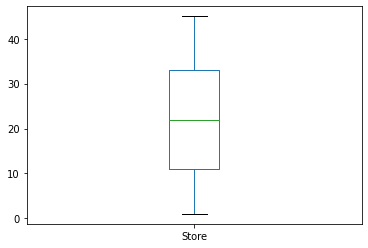

In [53]:
box_plot("Store")

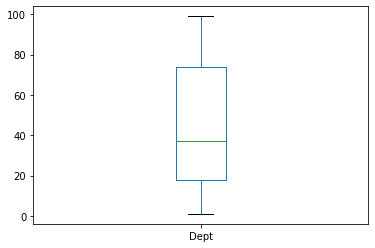

In [54]:
box_plot("Dept")

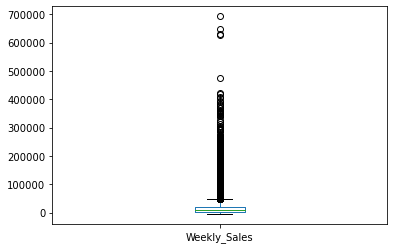

In [55]:
box_plot("Weekly_Sales")

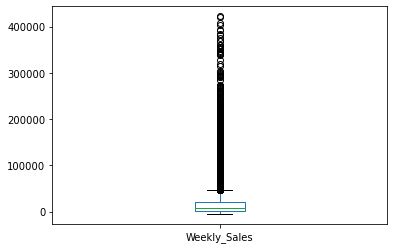

In [56]:
train_merge.drop(train_merge[train_merge['Weekly_Sales'] >= 473000].index, inplace = True)
box_plot("Weekly_Sales")

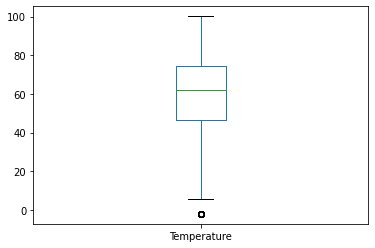

In [57]:
box_plot("Temperature")

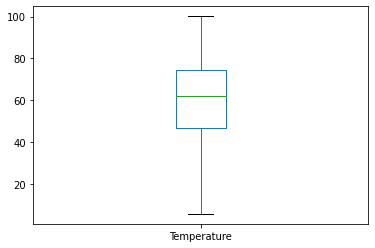

In [58]:
train_merge.loc[train_merge["Temperature"]<0,"Temperature"]=np.mean(train_merge["Temperature"])
box_plot("Temperature")

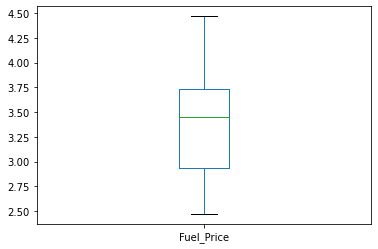

In [59]:
box_plot("Fuel_Price")

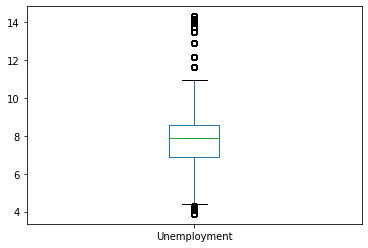

In [60]:
box_plot("Unemployment")

In [61]:
train_merge.describe()

,Store,Dept,Weekly_Sales,Temperature,Fuel_Price,CPI,Unemployment,Size,Week,Year,Day
count,421565.000000,421565.000000,421565.000000,421565.000000,421565.000000,421565.000000,421565.000000,421565.000000,421565.000000,421565.000000,421565.000000
mean,22.200562,44.259988,15974.150666,60.100335,3.361027,171.202278,7.960281,136727.968769,25.826511,2010.968598,15.673014
std,12.785309,30.492085,22615.912113,18.430859,0.458516,39.159327,1.863305,60980.818328,14.151783,0.796877,8.753534
min,1.000000,1.000000,-4988.940000,5.540000,2.472000,126.064000,3.879000,34875.000000,1.000000,2010.000000,1.000000
25%,11.000000,18.000000,2079.610000,46.700000,2.933000,132.022667,6.891000,93638.000000,14.000000,2010.000000,8.000000
50%,22.000000,37.000000,7612.010000,62.090000,3.452000,182.318780,7.866000,140167.000000,26.000000,2011.000000,16.000000
75%,33.000000,74.000000,20205.660000,74.280000,3.738000,212.416993,8.572000,202505.000000,38.000000,2012.000000,23.000000
max,45.000000,99.000000,422306.250000,100.140000,4.468000,227.232807,14.313000,219622.000000,52.000000,2012.000000,31.000000


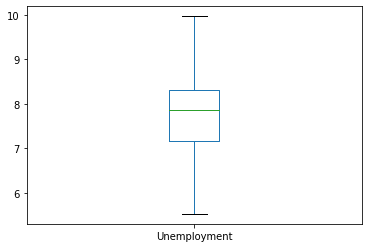

In [62]:
train_merge.loc[train_merge["Unemployment"]>10,"Unemployment"]=np.mean(train_merge["Unemployment"])
train_merge.loc[train_merge["Unemployment"]<5.5,"Unemployment"]=7.8
box_plot("Unemployment")

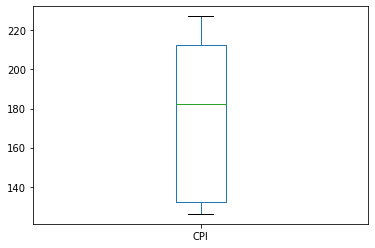

In [63]:
box_plot("CPI")

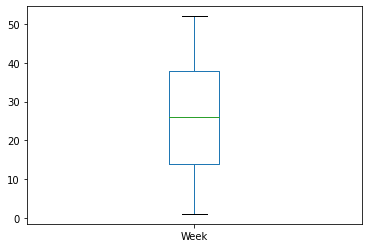

In [64]:
box_plot("Week")

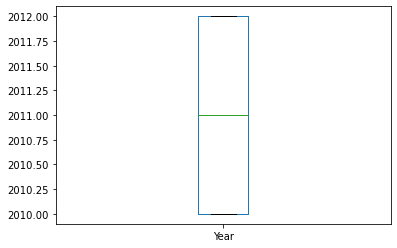

In [65]:
box_plot("Year")

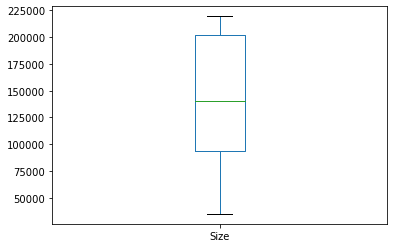

In [66]:
box_plot("Size")

# Univariate Analysis

In [67]:
# Defining the function to Create the Pie chart

def Pie(col):
    labels = train_merge[col].value_counts().index  # Taking the top 10 index
    values = train_merge[col].value_counts().values  # Taking the top 10 values

    colors=train_merge[col]

    fig = go.Figure(data=go.Pie(labels = labels, values=values, textinfo="label+percent", marker=dict(colors=colors)))

    fig.show()

In [68]:
Pie("Type")

In [69]:
Pie("IsHoliday")

In [70]:
Pie("Year")

In [71]:
# Defining the function to Create the histogram plt

def hist(col):
    plt.figure(figsize = (10,5))
    train_merge[col].plot.hist(bins=50,edgecolor = 'k')
    plt.title(col)
    plt.grid(color='k',linewidth=1)
    plt.show()
    return plt.show()

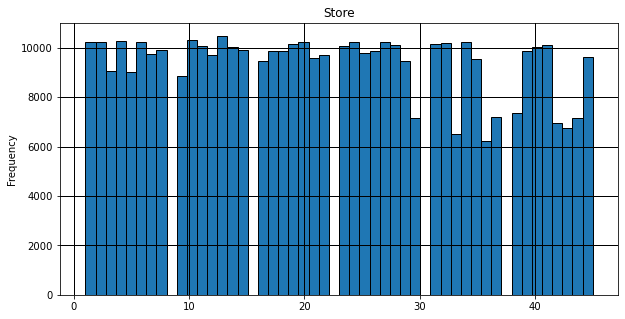

In [72]:
hist("Store")

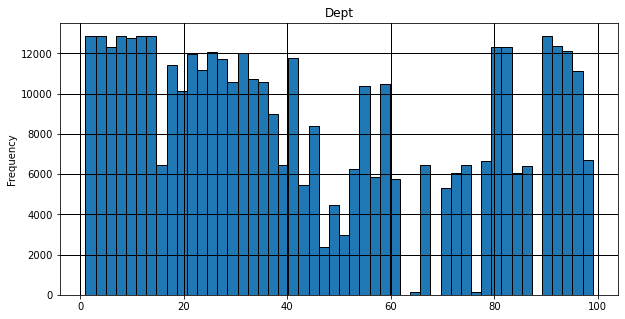

In [73]:
hist("Dept")

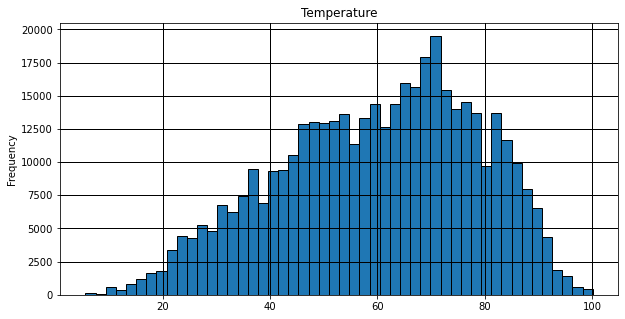

In [74]:
hist("Temperature")

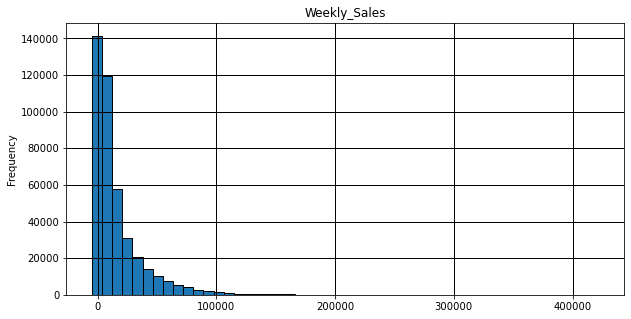

In [75]:
hist("Weekly_Sales")

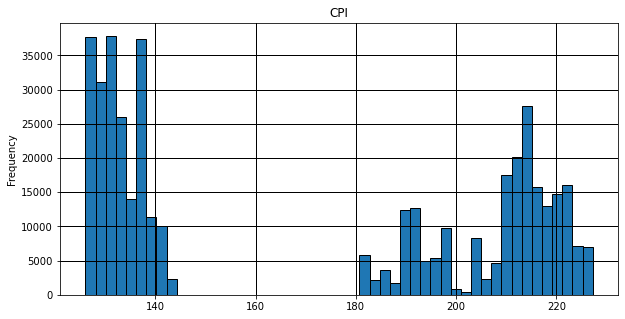

In [76]:
hist("CPI")

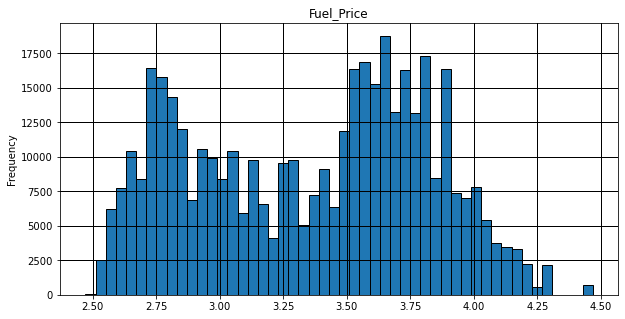

In [77]:
hist("Fuel_Price")

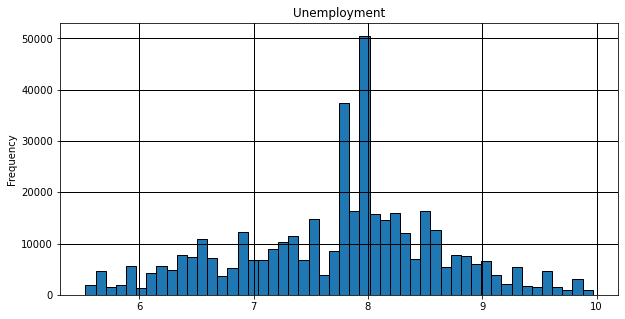

In [78]:
hist("Unemployment")

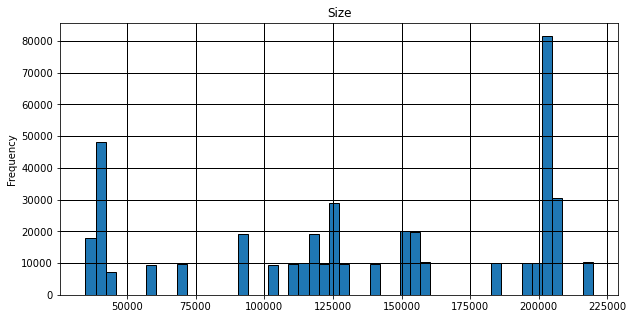

In [79]:
hist("Size")

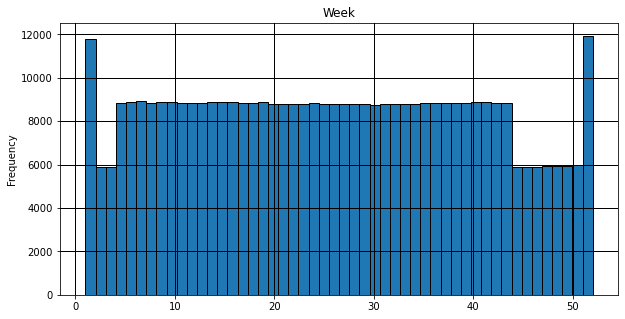

In [80]:
hist("Week")

# Bi-Variate Analysis

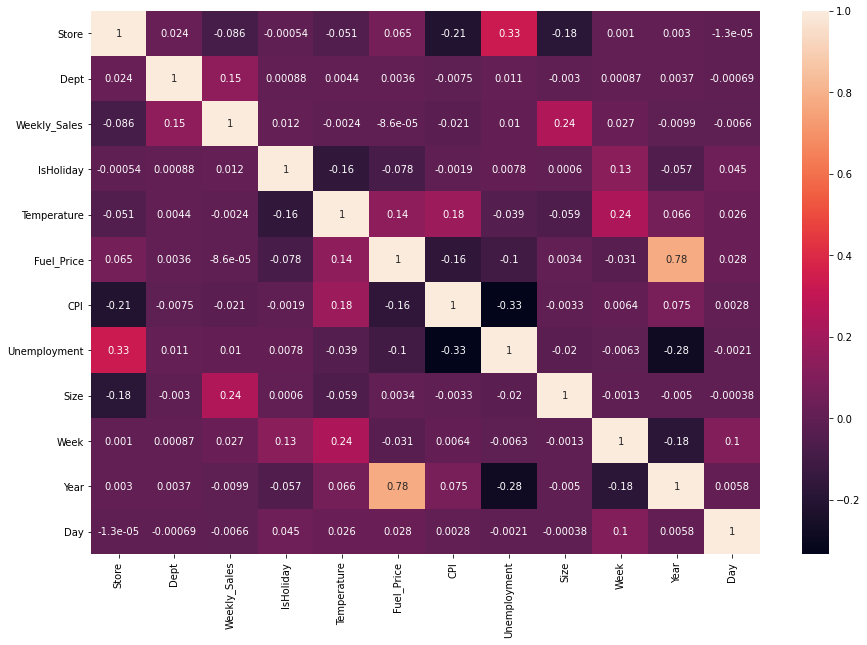

In [81]:
# Plotting correlation between all important features

corr = train_merge.corr()
plt.figure(figsize=(15, 10))
sns.heatmap(corr, annot=True)
plt.show()

In [82]:
# Defining the plot to create the jointplot

def jointplot(i):
    sns.jointplot(data=train_merge, x = i, y=train_merge['Weekly_Sales'],)
    return plt.show()

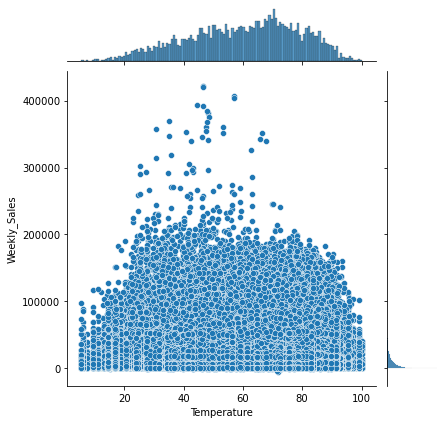

In [83]:
jointplot("Temperature")

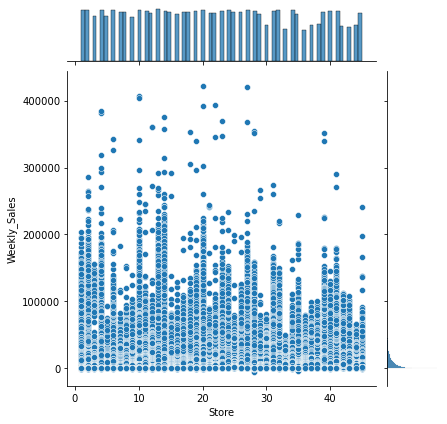

In [84]:
jointplot("Store")

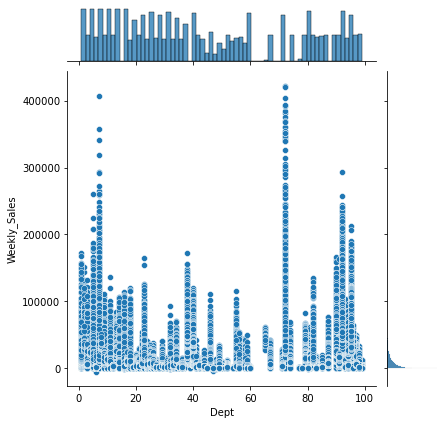

In [85]:
jointplot("Dept")

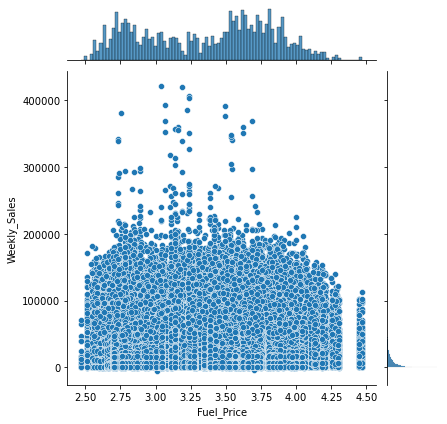

In [86]:
jointplot("Fuel_Price")

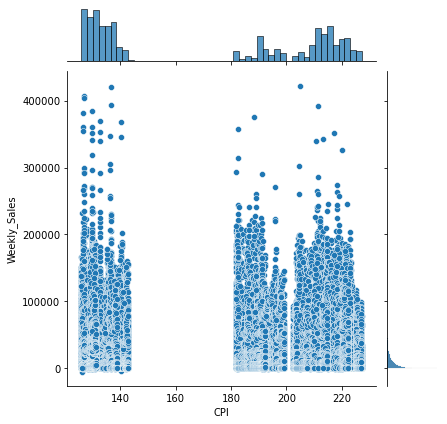

In [87]:
jointplot("CPI")

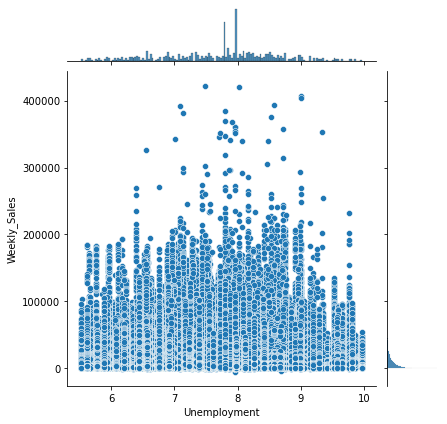

In [88]:
jointplot("Unemployment")

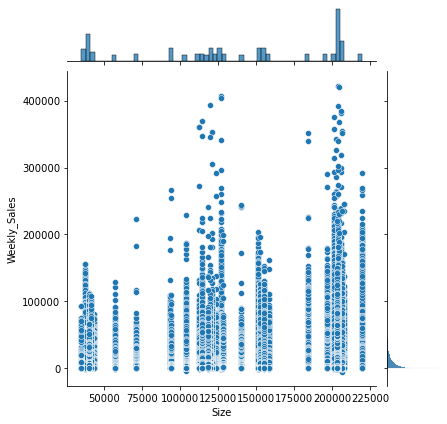

In [89]:
jointplot("Size")

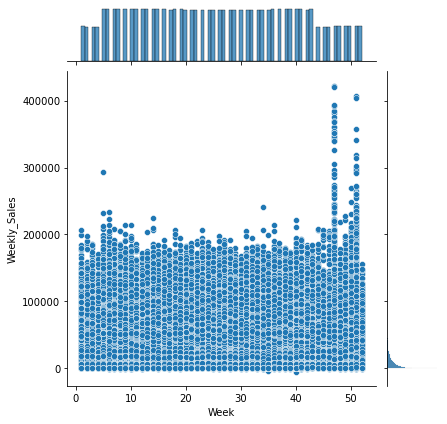

In [90]:
jointplot("Week")

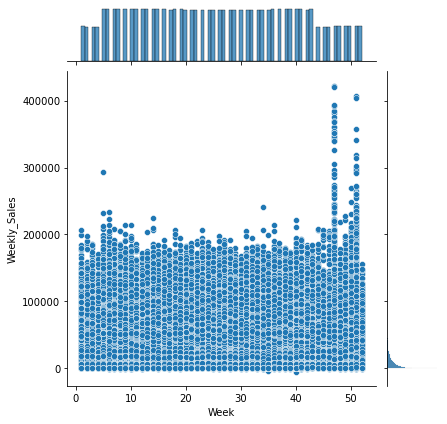

In [91]:
jointplot("Week")

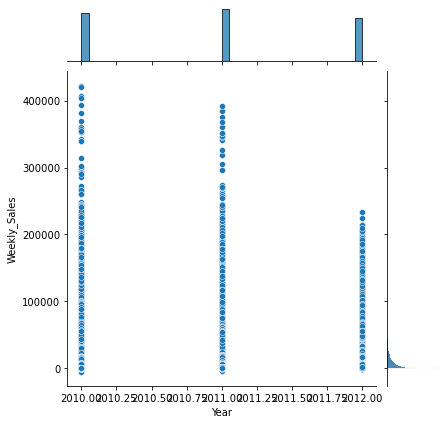

In [92]:
jointplot("Year")

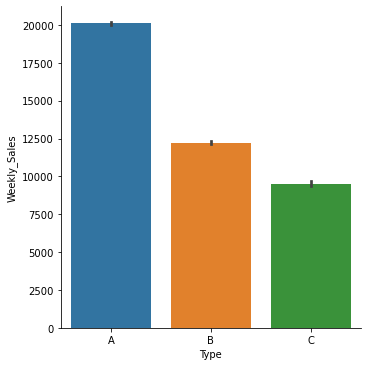

In [93]:
sns.catplot(x="Type", y="Weekly_Sales",kind="bar",data=train_merge)
plt.show()

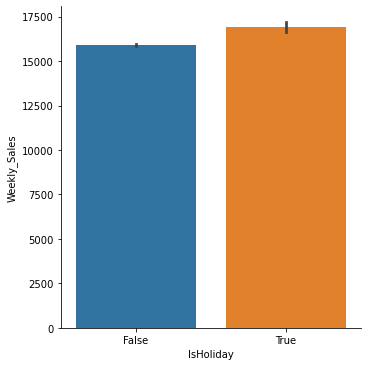

In [94]:
sns.catplot(x="IsHoliday", y="Weekly_Sales",kind="bar",data=train_merge)
plt.show()

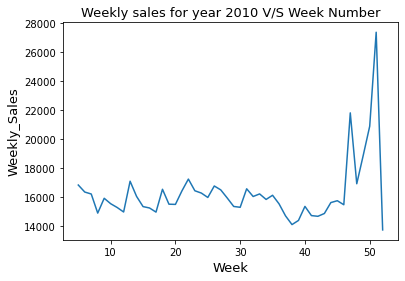

In [95]:
weekly_sales_2010 = train_merge[train_merge['Year']==2010]['Weekly_Sales'].groupby(train_merge['Week']).mean()
sns.lineplot(weekly_sales_2010.index, weekly_sales_2010.values)
plt.title("Weekly sales for year 2010 V/S Week Number",fontsize=13)
plt.ylabel("Weekly_Sales",fontsize=13)
plt.xlabel("Week",fontsize=13)
plt.show()

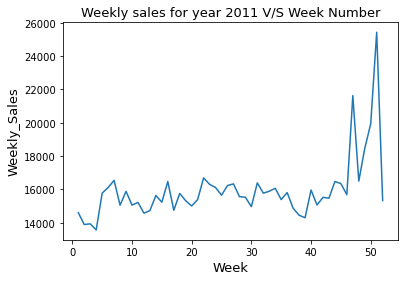

In [96]:
weekly_sales_2011 = train_merge[train_merge['Year']==2011]['Weekly_Sales'].groupby(train_merge['Week']).mean()
sns.lineplot(weekly_sales_2011.index, weekly_sales_2011.values)
plt.title("Weekly sales for year 2011 V/S Week Number",fontsize=13)
plt.ylabel("Weekly_Sales",fontsize=13)
plt.xlabel("Week",fontsize=13)
plt.show()

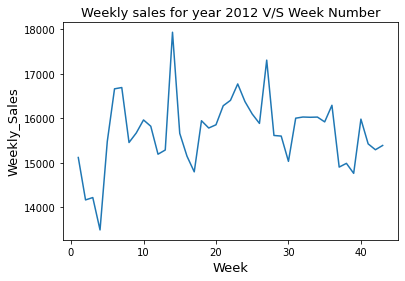

In [97]:
weekly_sales_2012 = train_merge[train_merge['Year']==2012]['Weekly_Sales'].groupby(train_merge['Week']).mean()
sns.lineplot(weekly_sales_2012.index, weekly_sales_2012.values)
plt.title("Weekly sales for year 2012 V/S Week Number",fontsize=13)
plt.ylabel("Weekly_Sales",fontsize=13)
plt.xlabel("Week",fontsize=13)
plt.show()

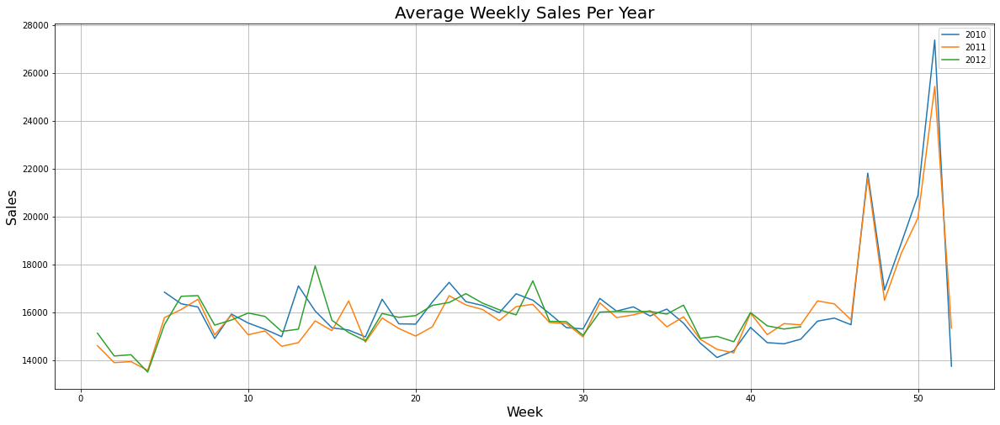

In [98]:
plt.figure(figsize=(20,8))
sns.lineplot(weekly_sales_2010.index, weekly_sales_2010.values)
sns.lineplot(weekly_sales_2011.index, weekly_sales_2011.values)
sns.lineplot(weekly_sales_2012.index, weekly_sales_2012.values)
plt.grid()
plt.legend(['2010', '2011', '2012'])
plt.title('Average Weekly Sales Per Year', fontsize=20)
plt.ylabel('Sales', fontsize=16)
plt.xlabel('Week', fontsize=16)
plt.show()

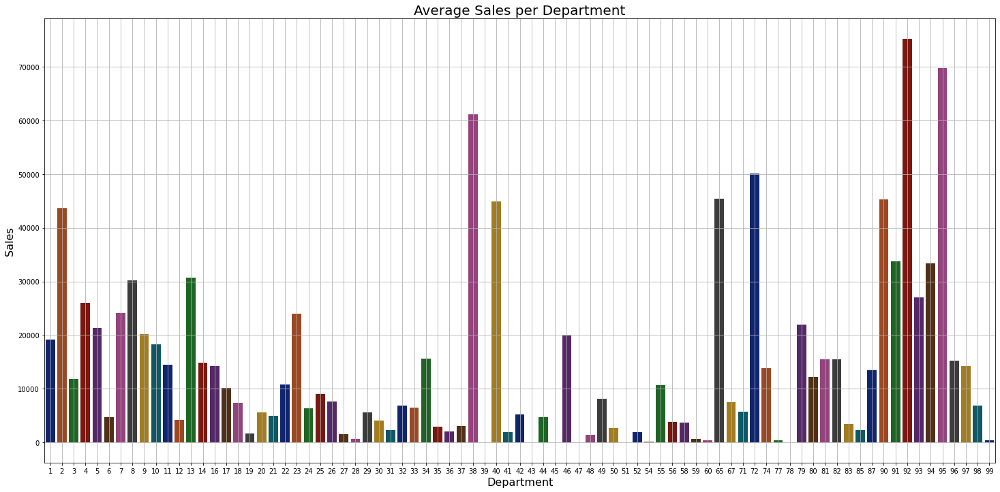

In [99]:
weekly_sales = train_merge['Weekly_Sales'].groupby(train_merge['Dept']).mean()
plt.figure(figsize=(25,12))
sns.barplot(weekly_sales.index, weekly_sales.values, palette='dark')
plt.grid()
plt.title('Average Sales per Department', fontsize=20)
plt.xlabel('Department', fontsize=16)
plt.ylabel('Sales', fontsize=16)
plt.show()

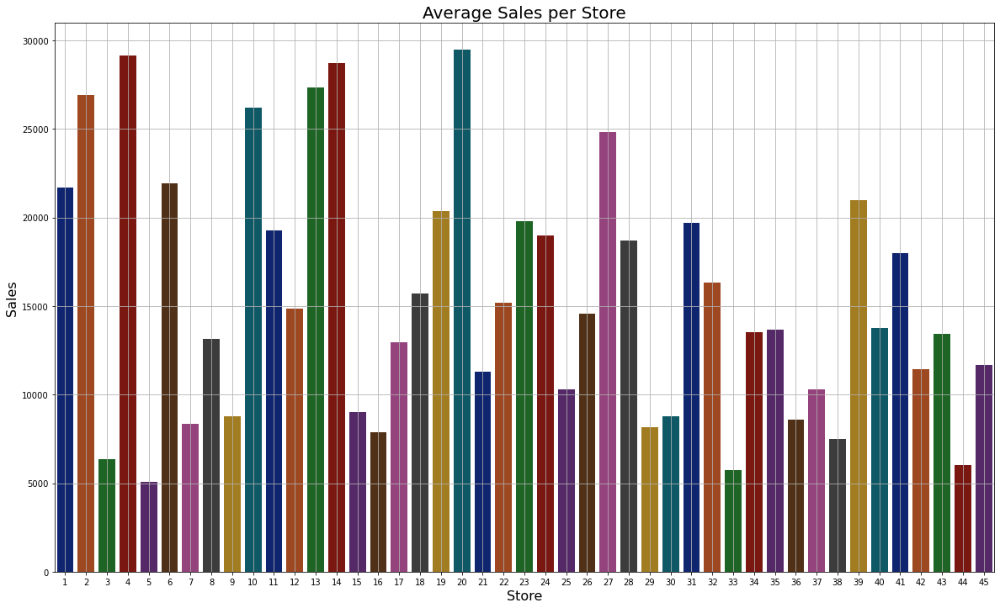

In [100]:
weekly_sales = train_merge['Weekly_Sales'].groupby(train_merge['Store']).mean()
plt.figure(figsize=(20,12))
sns.barplot(weekly_sales.index, weekly_sales.values, palette='dark')
plt.grid()
plt.title('Average Sales per Store', fontsize=20)
plt.xlabel('Store', fontsize=16)
plt.ylabel('Sales', fontsize=16)
plt.show()

# Creating the Dummy Variables 

In [101]:
train_merge= pd.get_dummies(train_merge)
test_merge = pd.get_dummies(test_merge)

# Splitting into the Features and Target

In [102]:
x = train_merge.drop("Weekly_Sales",axis=1)
y = train_merge["Weekly_Sales"]

# Scaling the Data

In [103]:
scaler = StandardScaler()
x_scaled = scaler.fit_transform(x)
test_scaled = scaler.fit_transform(test_merge)
x = pd.DataFrame(x_scaled,columns=x.columns)
test_merge = pd.DataFrame(test_scaled,columns=test_merge.columns)

In [104]:
test_merge.head()

,Store,Dept,IsHoliday,Temperature,Fuel_Price,CPI,Unemployment,Size,Week,Year,Day,Type_A,Type_B,Type_C
0,-1.657956,-1.413724,-0.290032,0.073606,-0.816679,1.420748,-0.447537,0.242483,1.330069,-1.815267,-1.535754,0.979679,-0.794124,-0.338852
1,-1.657956,-1.413724,-0.290032,0.389776,-1.117379,1.421296,-0.447537,0.242483,1.393560,-1.815267,-0.744335,0.979679,-0.794124,-0.338852
2,-1.657956,-1.413724,-0.290032,-0.054572,-1.376316,1.422232,-0.447537,0.242483,1.457050,-1.815267,0.047085,0.979679,-0.794124,-0.338852
3,-1.657956,-1.413724,3.447897,0.122206,-1.547548,1.423684,-0.447537,0.242483,1.520541,-1.815267,0.838505,0.979679,-0.794124,-0.338852
4,-1.657956,-1.413724,-0.290032,-0.085548,-1.564254,1.425135,-0.447537,0.242483,1.584032,-1.815267,1.629925,0.979679,-0.794124,-0.338852


In [105]:
x.head()

,Store,Dept,IsHoliday,Temperature,Fuel_Price,CPI,Unemployment,Size,Week,Year,Day,Type_A,Type_B,Type_C
0,-1.658199,-1.41873,-0.275083,-0.965248,-1.720830,1.018764,0.396277,0.239207,-1.471655,-1.215495,-1.219282,0.977971,-0.79593,-0.335265
1,-1.658199,-1.41873,3.635267,-1.171425,-1.773172,1.022488,0.396277,0.239207,-1.400992,-1.215495,-0.419604,0.977971,-0.79593,-0.335265
2,-1.658199,-1.41873,-0.275083,-1.094380,-1.847325,1.023687,0.396277,0.239207,-1.330329,-1.215495,0.380074,0.977971,-0.79593,-0.335265
3,-1.658199,-1.41873,-0.275083,-0.730859,-1.744820,1.024466,0.396277,0.239207,-1.259667,-1.215495,1.179752,0.977971,-0.79593,-0.335265
4,-1.658199,-1.41873,-0.275083,-0.737912,-1.605239,1.025245,0.396277,0.239207,-1.189004,-1.215495,-1.219282,0.977971,-0.79593,-0.335265


# Train Test Splitting

In [106]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 50)

# Decision Tree 

In [107]:
# Performing GridSearchCV on Decision Tree Regression

model1 = DecisionTreeRegressor(random_state=0)
model1.fit(X_train,y_train)

DecisionTreeRegressor(random_state=0)

In [108]:
# Predicting train and test results
model1_train_pred = model1.predict(X_train)
model1_test_pred = model1.predict(X_test)

In [109]:
print("Train Results for Decision Tree Regressor Model:")
print("Root Mean squared Error: ", sqrt(mse(y_train.values, model1_train_pred)))
print("R-Squared: ", r2_score(y_train.values, model1_train_pred))

Train Results for Decision Tree Regressor Model:
Root Mean squared Error:  9.452847826934942e-17
R-Squared:  1.0


In [110]:
print("Test Results for Decision Tree Regressor Model:")
print("Root Mean Squared Error: ", sqrt(mse(y_test, model1_test_pred)))
print("R-Squared: ", r2_score(y_test, model1_test_pred))

Test Results for Decision Tree Regressor Model:
Root Mean Squared Error:  4147.855775647406
R-Squared:  0.9655499361794947


# Generating the Final Pridections

In [111]:
model1.predict(test_merge)

array([20911.25, 20911.25, 20911.25, ...,   599.03,   599.03,   599.03])